## Embedding

### Create a dense BQM

In [1]:
import dwave_utils.utils as dwu 

bqm = dwu.random_dense_bqm(5)

## Embedding experiments on the QPU
### We are going to explore different embedding options that dwu provides

In [2]:
new_bqm, emb = dwu.embedded_bqm(bqm, 
                                target='advantage',      # Advantage QPU
                                chain_strength=None,     # use the default uniform_torque_compensation
                                clique = False,          # do not use minorminer clique embedding
                                return_embedding=True)   # also return the embedding graph

### Let's get some info about this new BQM and also the embedding performed:

In [3]:
dwu.compare_bqm(bqm,new_bqm,emb)

Old BQM var:  5 
New BQM var:  6 
Extra qubits needed:  1
Old BQM connectivity:  1.0 
New BQM connectivity:  0.7333333333333333
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5


{'min_chain': 1,
 'max_chain': 2,
 'total_chain': 5,
 'old_var': 5,
 'new_var': 6,
 'extra_qubits': 1,
 'old_connectivity': 1.0,
 'new_connectivity': 0.7333333333333333}

### Embed on D-Wave 2000Q QPU:

In [4]:
new_bqm_2000, emb_2000 = dwu.embedded_bqm(bqm, 
                                          target='2000',           # 2000 QPU
                                          chain_strength=None,     # use the default uniform_torque_compensation
                                          clique = False,          # do not use minorminer clique embedding
                                          return_embedding=True)   # also return the embedding graph

In [5]:
print("compare with unembedded BQM: ", dwu.compare_bqm(bqm,new_bqm_2000,emb))
print()
print("compare Advantage and 2000Q embedded BQMs: ", dwu.compare_bqm(new_bqm,new_bqm_2000,emb))


Old BQM var:  5 
New BQM var:  8 
Extra qubits needed:  3
Old BQM connectivity:  1.0 
New BQM connectivity:  0.5714285714285714
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5
compare with unembedded BQM:  {'min_chain': 1, 'max_chain': 2, 'total_chain': 5, 'old_var': 5, 'new_var': 8, 'extra_qubits': 3, 'old_connectivity': 1.0, 'new_connectivity': 0.5714285714285714}

Old BQM var:  6 
New BQM var:  8 
Extra qubits needed:  2
Old BQM connectivity:  0.7333333333333333 
New BQM connectivity:  0.5714285714285714
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5
compare Advantage and 2000Q embedded BQMs:  {'min_chain': 1, 'max_chain': 2, 'total_chain': 5, 'old_var': 6, 'new_var': 8, 'extra_qubits': 2, 'old_connectivity': 0.7333333333333333, 'new_connectivity': 0.5714285714285714}


### There is a function for that! Comparing straight away Advantage and 2000Q

In [6]:
dwu.compare_solvers(bqm)

advantage
Old BQM var:  5 
New BQM var:  6 
Extra qubits needed:  1
Old BQM connectivity:  1.0 
New BQM connectivity:  0.7333333333333333
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5

 2000
Old BQM var:  5 
New BQM var:  8 
Extra qubits needed:  3
Old BQM connectivity:  1.0 
New BQM connectivity:  0.5714285714285714
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5


({'min_chain': 1,
  'max_chain': 2,
  'total_chain': 5,
  'old_var': 5,
  'new_var': 6,
  'extra_qubits': 1,
  'old_connectivity': 1.0,
  'new_connectivity': 0.7333333333333333},
 {'min_chain': 1,
  'max_chain': 2,
  'total_chain': 5,
  'old_var': 5,
  'new_var': 8,
  'extra_qubits': 3,
  'old_connectivity': 1.0,
  'new_connectivity': 0.5714285714285714})

### These embeddings are ready for QA computation. We can also use "chimera", "pegasus" embeddings to find out more properties about the BQM. We can also testthe new zephyr architecture

### I want to see how the clique embedding performs on a dense BQM

In [7]:
report_adv = []
c_report_adv = []
report_2000 = []
c_report_2000 = []
report_zephyr = []

for i in range(2,50): 
    bqm = dwu.random_dense_bqm(i)
    print('size: ',i)    
    
    adv_bqm, adv_emb = dwu.embedded_bqm(bqm, 
                                        target='pegasus',        
                                        chain_strength=None,     
                                        clique = False,
                                       return_embedding=True) 
    rep_adv = dwu.compare_bqm(bqm, adv_bqm, adv_emb)
    
    
    c_adv_bqm, c_adv_emb = dwu.embedded_bqm(bqm, 
                                            target='pegasus',        
                                            chain_strength=None,     
                                            clique = True,
                                            return_embedding=True) 
    c_rep_adv = dwu.compare_bqm(bqm, c_adv_bqm, c_adv_emb)
    
    _2000_bqm, _2000_emb = dwu.embedded_bqm(bqm, 
                                target='chimera',        
                                chain_strength=None,     
                                clique = False,
                                return_embedding=True) 
    rep_2000 = dwu.compare_bqm(bqm, _2000_bqm, _2000_emb)
    
    c_2000_bqm, c_2000_emb = dwu.embedded_bqm(bqm, 
                                              target='chimera',        
                                              chain_strength=None,     
                                              clique = True,
                                              return_embedding=True) 
    c_rep_2000 = dwu.compare_bqm(bqm, c_2000_bqm, c_2000_emb)

    zephyr_bqm, zephyr_emb = dwu.embedded_bqm(bqm, 
                                  target='zephyr',        
                                  chain_strength=None,     
                                  clique = False,
                                  return_embedding=True)     
    rep_zephyr = dwu.compare_bqm(bqm, zephyr_bqm, zephyr_emb)
    
    report_adv.append(rep_adv)
    c_report_adv.append(c_rep_adv)
    report_2000.append(rep_2000)
    c_report_2000.append(c_rep_2000)
    report_zephyr.append(rep_zephyr)

size:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
size:  3
Old BQM var:  3 
New BQM var:  3 
Extra qubits needed:  0
Old BQM connec

Old BQM var:  10 
New BQM var:  17 
Extra qubits needed:  7
Old BQM connectivity:  1.0 
New BQM connectivity:  0.4852941176470588
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  10
size:  11
Old BQM var:  11 
New BQM var:  22 
Extra qubits needed:  11
Old BQM connectivity:  1.0 
New BQM connectivity:  0.354978354978355
Shortest chain is:  1
Longest chain is:  3
Total num of chain is:  11
Old BQM var:  11 
New BQM var:  33 
Extra qubits needed:  22
Old BQM connectivity:  1.0 
New BQM connectivity:  0.19128787878787878
Shortest chain is:  3
Longest chain is:  3
Total num of chain is:  11
Old BQM var:  11 
New BQM var:  41 
Extra qubits needed:  30
Old BQM connectivity:  1.0 
New BQM connectivity:  0.11341463414634147
Shortest chain is:  3
Longest chain is:  4
Total num of chain is:  11
Old BQM var:  11 
New BQM var:  44 
Extra qubits needed:  33
Old BQM connectivity:  1.0 
New BQM connectivity:  0.10887949260042283
Shortest chain is:  4
Longest chain is:  4
Total num o

Old BQM var:  19 
New BQM var:  51 
Extra qubits needed:  32
Old BQM connectivity:  1.0 
New BQM connectivity:  0.19607843137254902
Shortest chain is:  2
Longest chain is:  3
Total num of chain is:  19
Old BQM var:  19 
New BQM var:  57 
Extra qubits needed:  38
Old BQM connectivity:  1.0 
New BQM connectivity:  0.16228070175438597
Shortest chain is:  3
Longest chain is:  3
Total num of chain is:  19
Old BQM var:  19 
New BQM var:  122 
Extra qubits needed:  103
Old BQM connectivity:  1.0 
New BQM connectivity:  0.04050941606828343
Shortest chain is:  5
Longest chain is:  7
Total num of chain is:  19
Old BQM var:  19 
New BQM var:  114 
Extra qubits needed:  95
Old BQM connectivity:  1.0 
New BQM connectivity:  0.04548983077161931
Shortest chain is:  6
Longest chain is:  6
Total num of chain is:  19
Old BQM var:  19 
New BQM var:  44 
Extra qubits needed:  25
Old BQM connectivity:  1.0 
New BQM connectivity:  0.26109936575052856
Shortest chain is:  2
Longest chain is:  3
Total num of c

Old BQM var:  27 
New BQM var:  230 
Extra qubits needed:  203
Old BQM connectivity:  1.0 
New BQM connectivity:  0.02263147902031517
Shortest chain is:  7
Longest chain is:  10
Total num of chain is:  27
Old BQM var:  27 
New BQM var:  216 
Extra qubits needed:  189
Old BQM connectivity:  1.0 
New BQM connectivity:  0.024935400516795866
Shortest chain is:  8
Longest chain is:  8
Total num of chain is:  27
Old BQM var:  27 
New BQM var:  81 
Extra qubits needed:  54
Old BQM connectivity:  1.0 
New BQM connectivity:  0.16358024691358025
Shortest chain is:  2
Longest chain is:  4
Total num of chain is:  27
size:  28
Old BQM var:  28 
New BQM var:  108 
Extra qubits needed:  80
Old BQM connectivity:  1.0 
New BQM connectivity:  0.1026306680512288
Shortest chain is:  3
Longest chain is:  6
Total num of chain is:  28
Old BQM var:  28 
New BQM var:  106 
Extra qubits needed:  78
Old BQM connectivity:  1.0 
New BQM connectivity:  0.09973045822102426
Shortest chain is:  3
Longest chain is:  4


Old BQM var:  35 
New BQM var:  393 
Extra qubits needed:  358
Old BQM connectivity:  1.0 
New BQM connectivity:  0.01356649530041024
Shortest chain is:  9
Longest chain is:  14
Total num of chain is:  35
Old BQM var:  35 
New BQM var:  350 
Extra qubits needed:  315
Old BQM connectivity:  1.0 
New BQM connectivity:  0.01573475235366353
Shortest chain is:  10
Longest chain is:  10
Total num of chain is:  35
Old BQM var:  35 
New BQM var:  129 
Extra qubits needed:  94
Old BQM connectivity:  1.0 
New BQM connectivity:  0.11143410852713179
Shortest chain is:  3
Longest chain is:  5
Total num of chain is:  35
size:  36
Old BQM var:  36 
New BQM var:  168 
Extra qubits needed:  132
Old BQM connectivity:  1.0 
New BQM connectivity:  0.06665240946678072
Shortest chain is:  3
Longest chain is:  6
Total num of chain is:  36
Old BQM var:  36 
New BQM var:  172 
Extra qubits needed:  136
Old BQM connectivity:  1.0 
New BQM connectivity:  0.06133550931592547
Shortest chain is:  4
Longest chain is

Old BQM var:  43 
New BQM var:  629 
Extra qubits needed:  586
Old BQM connectivity:  1.0 
New BQM connectivity:  0.008369365993944488
Shortest chain is:  11
Longest chain is:  19
Total num of chain is:  43
Old BQM var:  43 
New BQM var:  516 
Extra qubits needed:  473
Old BQM connectivity:  1.0 
New BQM connectivity:  0.010830134718145555
Shortest chain is:  12
Longest chain is:  12
Total num of chain is:  43
Old BQM var:  43 
New BQM var:  197 
Extra qubits needed:  154
Old BQM connectivity:  1.0 
New BQM connectivity:  0.07645291619185746
Shortest chain is:  4
Longest chain is:  6
Total num of chain is:  43
size:  44
Old BQM var:  44 
New BQM var:  257 
Extra qubits needed:  213
Old BQM connectivity:  1.0 
New BQM connectivity:  0.046267023346303504
Shortest chain is:  4
Longest chain is:  8
Total num of chain is:  44
Old BQM var:  44 
New BQM var:  256 
Extra qubits needed:  212
Old BQM connectivity:  1.0 
New BQM connectivity:  0.041299019607843136
Shortest chain is:  5
Longest ch

### Plot the connectivity of the embedding as function of original qubits

<AxesSubplot:>

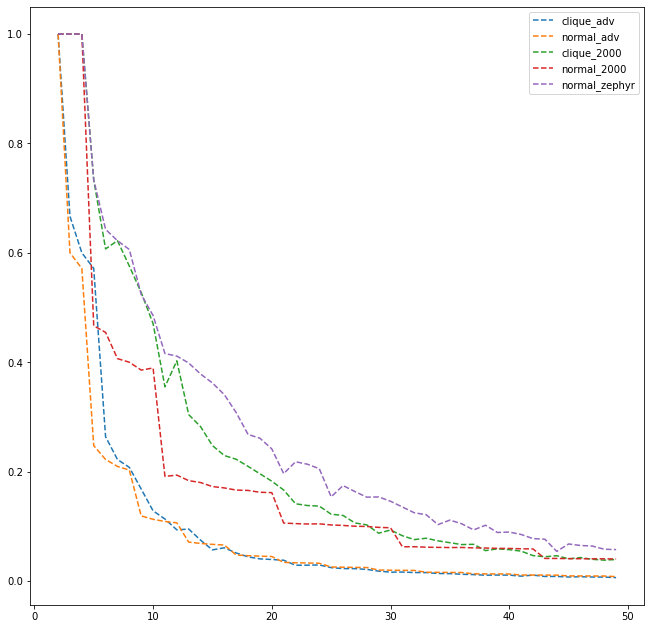

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt

x = [_ for _ in range(2,i+1)]
y1 = [d['new_connectivity'] for d in report_2000]
y2 = [d['new_connectivity'] for d in c_report_2000]
y3 = [d['new_connectivity'] for d in report_adv]
y4 = [d['new_connectivity'] for d in c_report_adv]
y5 = [d['new_connectivity'] for d in report_zephyr]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x,y=y1,linestyle='dashed',label='clique_adv')
sns.lineplot(x=x,y=y2,linestyle='dashed',label='normal_adv')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='normal_2000')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='normal_zephyr')

### Plot the number of necessary additional qubits as function of original qubits

<AxesSubplot:>

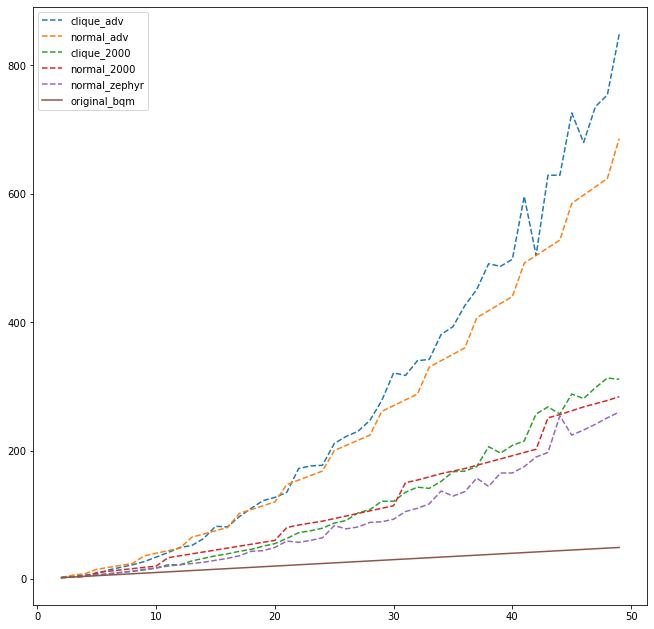

In [9]:
import seaborn as sns
import matplotlib.pyplot as plt

x = [_ for _ in range(2,i+1)]
y1 = [d['new_var'] for d in report_2000]
y2 = [d['new_var'] for d in c_report_2000]
y3 = [d['new_var'] for d in report_adv]
y4 = [d['new_var'] for d in c_report_adv]
y5 = [d['new_var'] for d in report_zephyr]
y6 = [d['old_var'] for d in c_report_adv]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x,y=y1,linestyle='dashed',label='clique_adv')
sns.lineplot(x=x,y=y2,linestyle='dashed',label='normal_adv')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='normal_2000')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='normal_zephyr')
sns.lineplot(x=x,y=y6,label='original_bqm')

## Plot minimum and maximum length of chains

<AxesSubplot:>

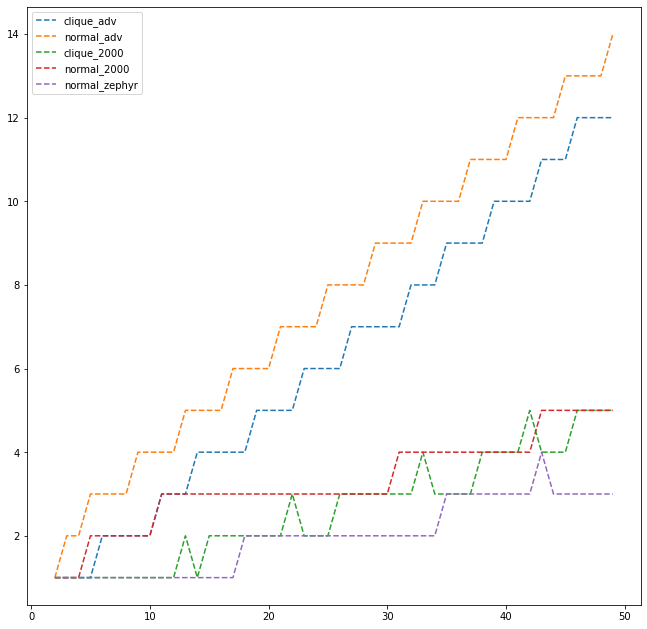

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt

x = [_ for _ in range(2,i+1)]
y1 = [d['min_chain'] for d in report_2000]
y2 = [d['min_chain'] for d in c_report_2000]
y3 = [d['min_chain'] for d in report_adv]
y4 = [d['min_chain'] for d in c_report_adv]
y5 = [d['min_chain'] for d in report_zephyr]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x,y=y1,linestyle='dashed',label='clique_adv')
sns.lineplot(x=x,y=y2,linestyle='dashed',label='normal_adv')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='normal_2000')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='normal_zephyr')

<AxesSubplot:>

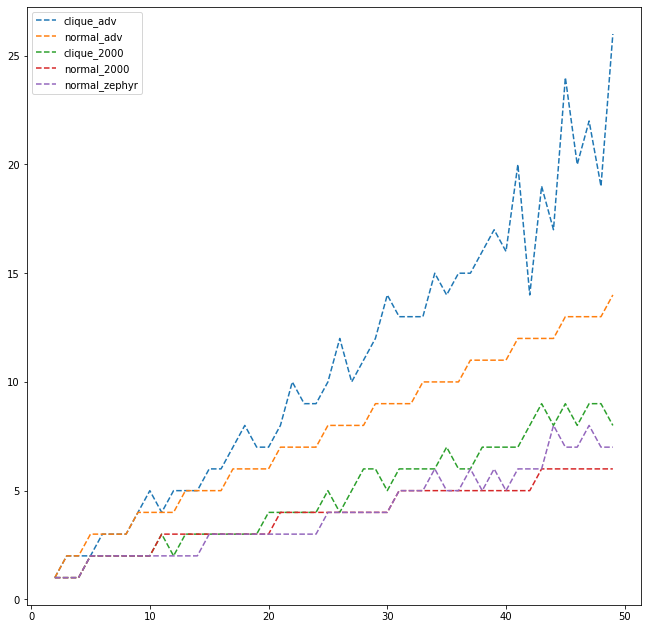

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt

x = [_ for _ in range(2,i+1)]
y1 = [d['max_chain'] for d in report_2000]
y2 = [d['max_chain'] for d in c_report_2000]
y3 = [d['max_chain'] for d in report_adv]
y4 = [d['max_chain'] for d in c_report_adv]
y5 = [d['max_chain'] for d in report_zephyr]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x,y=y1,linestyle='dashed',label='clique_adv')
sns.lineplot(x=x,y=y2,linestyle='dashed',label='normal_adv')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='normal_2000')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='normal_zephyr')

## The chain scenario is better investigated in its distribution, with each chain length with the corresponding occurrence

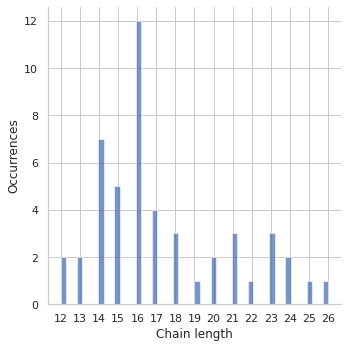

In [12]:
dwu.chain_histogram(_2000_emb)

### You can also easily visualize the embeddings

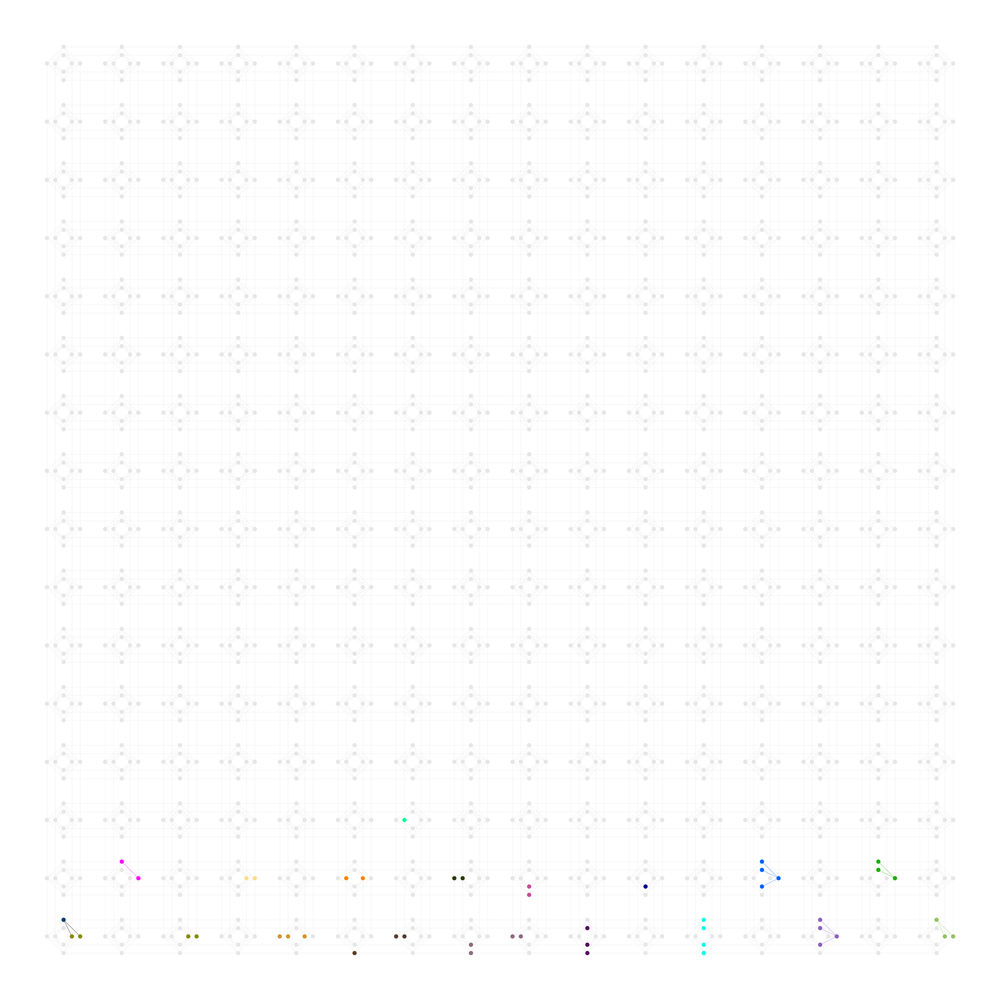

In [13]:
# DWave 2000Q

import dwave_networkx as dnx
plt.figure(figsize=(60.96,60.96))
chimera_graph = dnx.chimera_graph(16)
dnx.draw_chimera_embedding(chimera_graph, adv_emb)

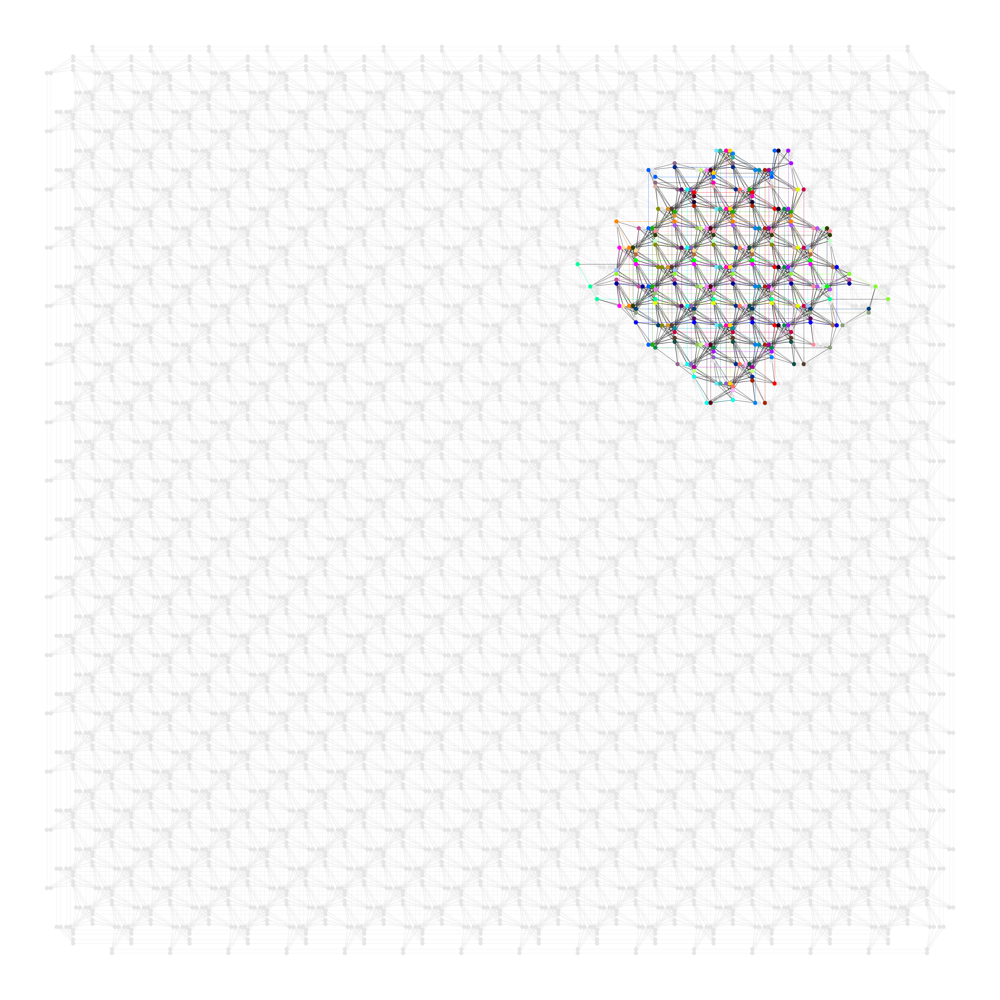

In [14]:
# Advantage

plt.figure(figsize=(60.96,60.96))
pegasus_graph = dnx.pegasus_graph(16)
dnx.draw_pegasus_embedding(pegasus_graph, adv_emb)

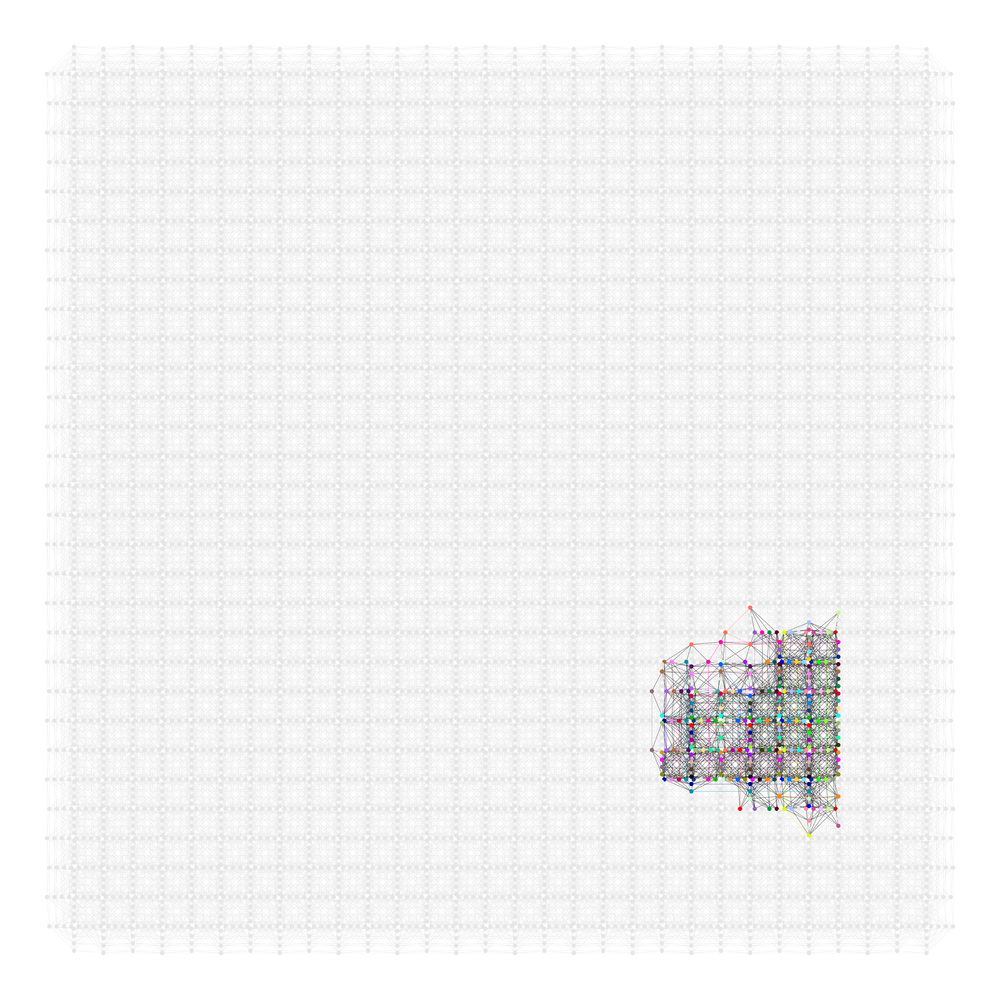

In [15]:
# Zephyr

plt.figure(figsize=(60.96,60.96))
zephyr_graph = dnx.zephyr_graph(15)
dnx.draw_zephyr_embedding(zephyr_graph, zephyr_emb)